In [1]:
import os
import numpy as np
from scipy.io import loadmat
from scipy.interpolate import RectBivariateSpline
import scipy.optimize as opt
import glob
import matplotlib.pyplot as plt
%matplotlib inline

Display distribution of points at which PRF was sampled on each camera.

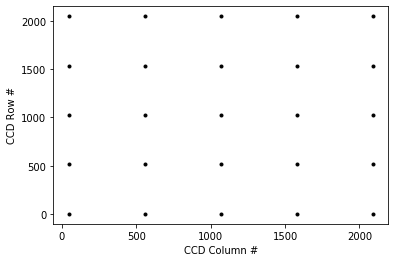

In [2]:
mat = loadmat('../data/tess_prf/s0001/tess2018243163600-00072_035-2-3-characterized-prf.mat')
mat = mat['prfStruct']
    
plt.plot(mat['ccdColumn'][0],mat['ccdRow'][0],'k.')
plt.ylabel('CCD Row #')
plt.xlabel('CCD Column #')
plt.show()

Fit each PRF to a Gaussian to see how they line up.

In [3]:
# PRFs for sectors 1-3
sector1_files = ['tess2018243163600-00072_035-1-1-characterized-prf.mat',
                 'tess2018243163600-00072_035-1-2-characterized-prf.mat',
                 'tess2018243163600-00072_035-1-3-characterized-prf.mat',
                 'tess2018243163600-00072_035-1-4-characterized-prf.mat',
                 'tess2018243163600-00072_035-2-1-characterized-prf.mat',
                 'tess2018243163600-00072_035-2-2-characterized-prf.mat',
                 'tess2018243163600-00072_035-2-3-characterized-prf.mat',
                 'tess2018243163601-00072_035-2-4-characterized-prf.mat',
                 'tess2018243163601-00072_035-3-1-characterized-prf.mat',
                 'tess2018243163601-00072_035-3-2-characterized-prf.mat',
                 'tess2018243163601-00072_035-3-3-characterized-prf.mat',
                 'tess2018243163601-00072_035-3-4-characterized-prf.mat',
                 'tess2018243163601-00072_035-4-1-characterized-prf.mat',
                 'tess2018243163601-00072_035-4-2-characterized-prf.mat',
                 'tess2018243163601-00072_035-4-3-characterized-prf.mat',
                 'tess2018243163601-00072_035-4-4-characterized-prf.mat']
# PRFs for sectors 4 and beyond
sector4_files = ['tess2019107181900-00195_045-1-1-characterized-prf.mat',
                 'tess2019107181901-00195_045-1-2-characterized-prf.mat',
                 'tess2019107181901-00195_045-1-3-characterized-prf.mat',
                 'tess2019107181901-00195_045-1-4-characterized-prf.mat',
                 'tess2019107181901-00195_045-2-1-characterized-prf.mat',
                 'tess2019107181901-00195_045-2-2-characterized-prf.mat',
                 'tess2019107181901-00195_045-2-3-characterized-prf.mat',
                 'tess2019107181901-00195_045-2-4-characterized-prf.mat',
                 'tess2019107181901-00195_045-3-1-characterized-prf.mat',
                 'tess2019107181902-00195_045-3-2-characterized-prf.mat',
                 'tess2019107181902-00195_045-3-3-characterized-prf.mat',
                 'tess2019107181902-00195_045-3-4-characterized-prf.mat',
                 'tess2019107181902-00195_045-4-1-characterized-prf.mat',
                 'tess2019107181902-00195_045-4-2-characterized-prf.mat',
                 'tess2019107181902-00195_045-4-3-characterized-prf.mat',
                 'tess2019107181902-00195_045-4-4-characterized-prf.mat']

# Fit these to circular Gaussians
def twoD_Gaussian(coords, A, xo, yo, sigma, offset):
    xo = float(xo)
    yo = float(yo)    
    a = 1/(2 * sigma**2)
    c = 1/(2 * sigma**2)
    g = offset + A*np.exp( - (a*((coords[0]-xo)**2) + c*((coords[1]-yo)**2)))
    return g.ravel()

Camera 1 CCD 1


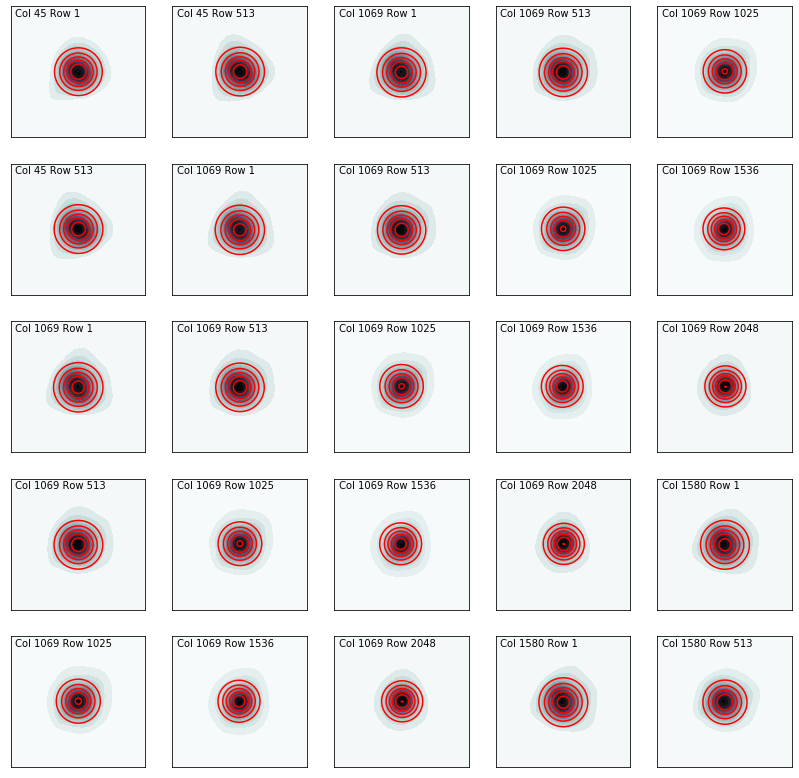



Camera 1 CCD 2


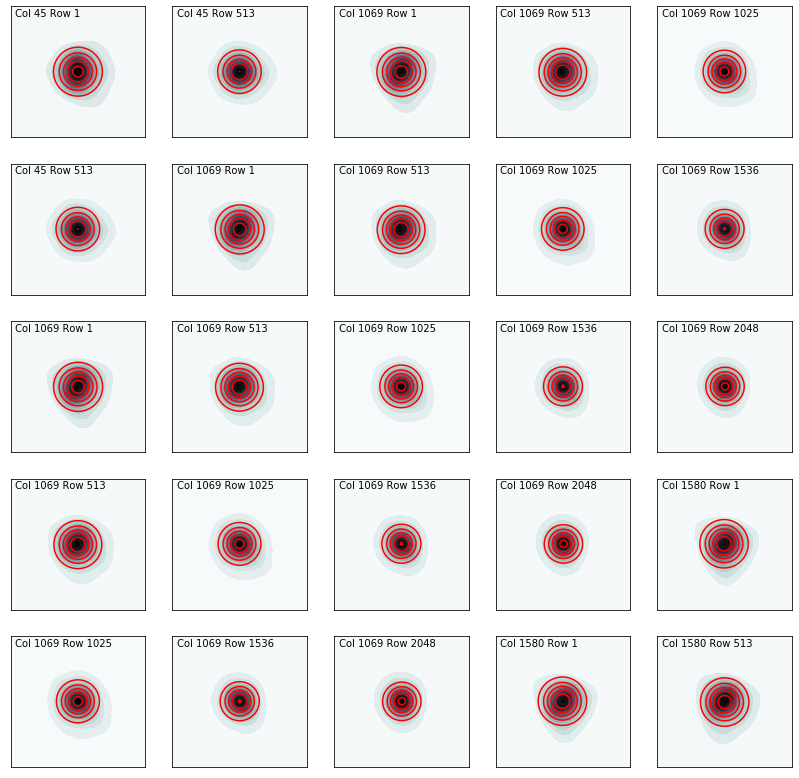



Camera 1 CCD 3


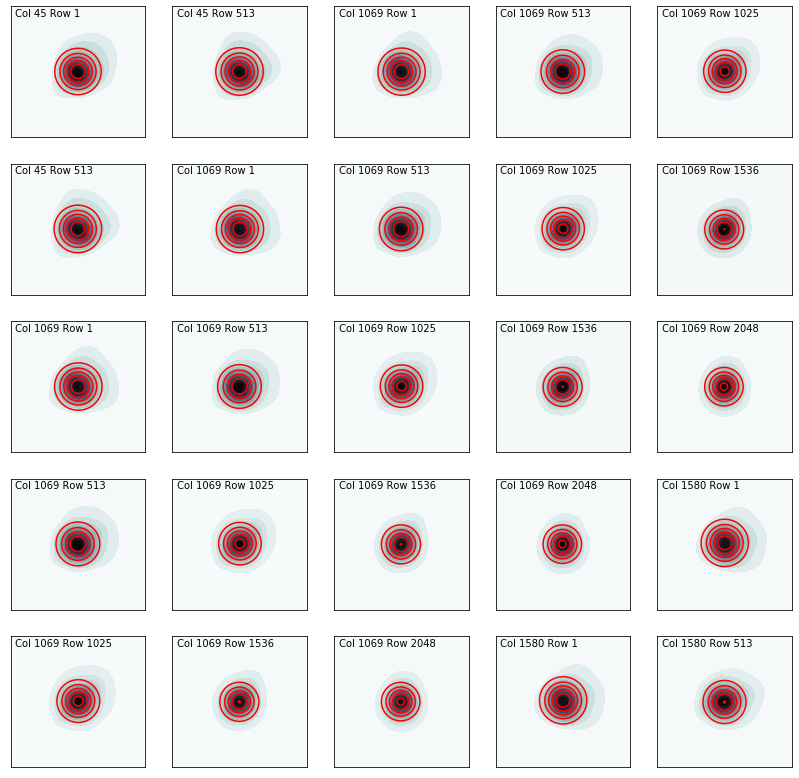



Camera 1 CCD 4


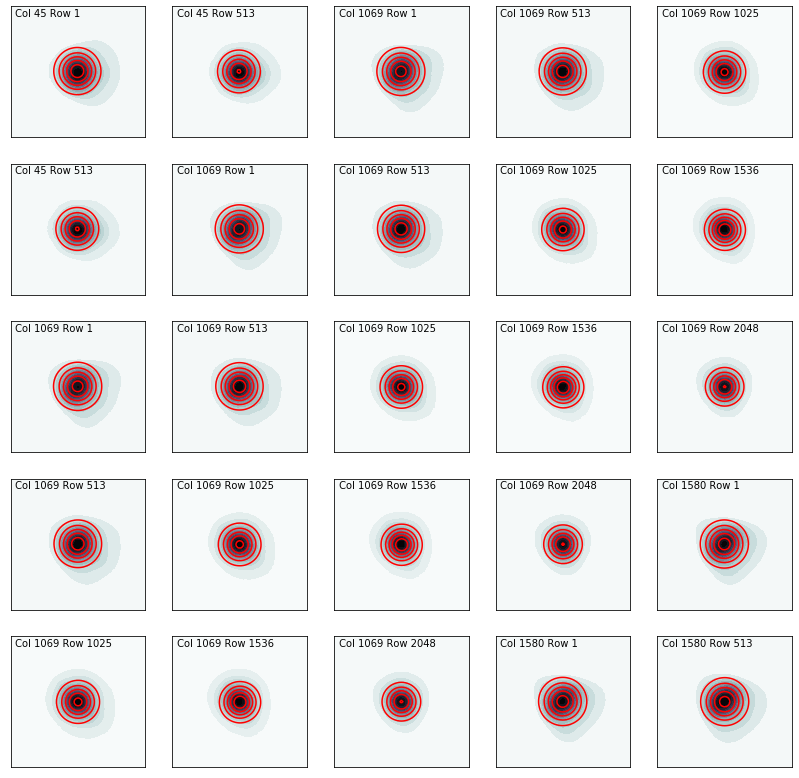



Camera 2 CCD 1


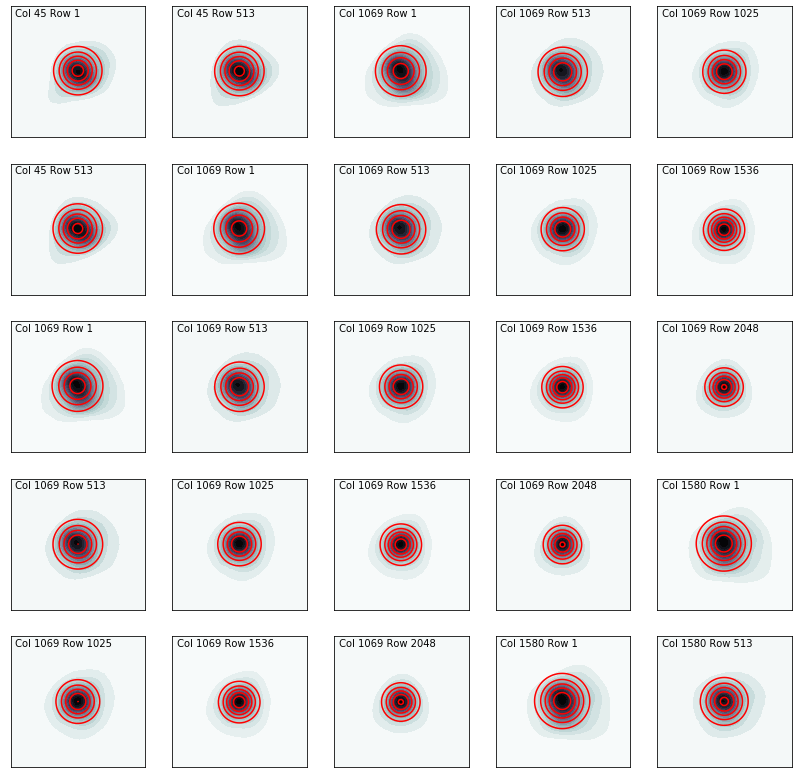



Camera 2 CCD 2


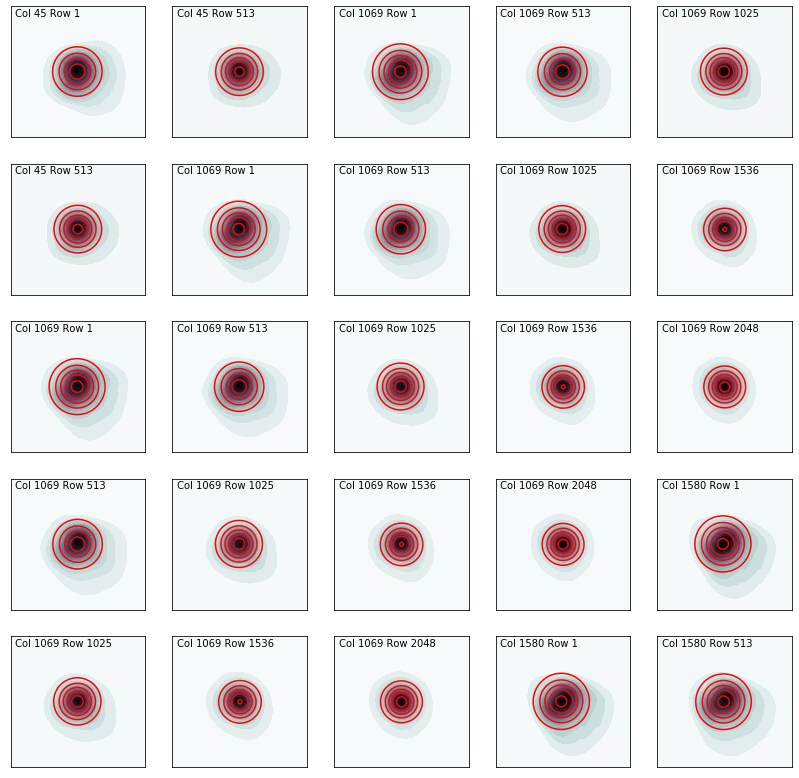



Camera 2 CCD 3


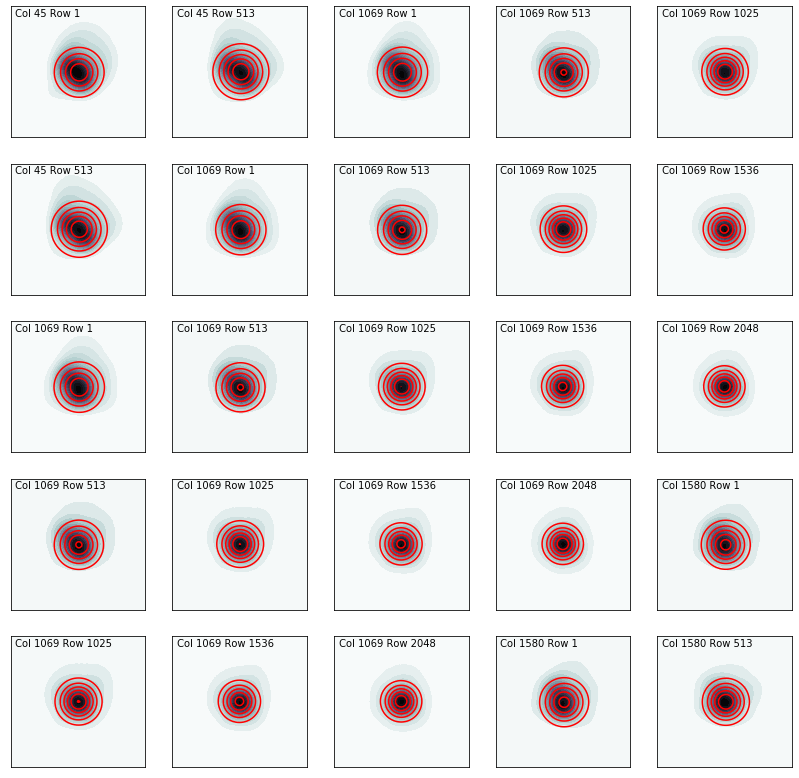



Camera 2 CCD 4


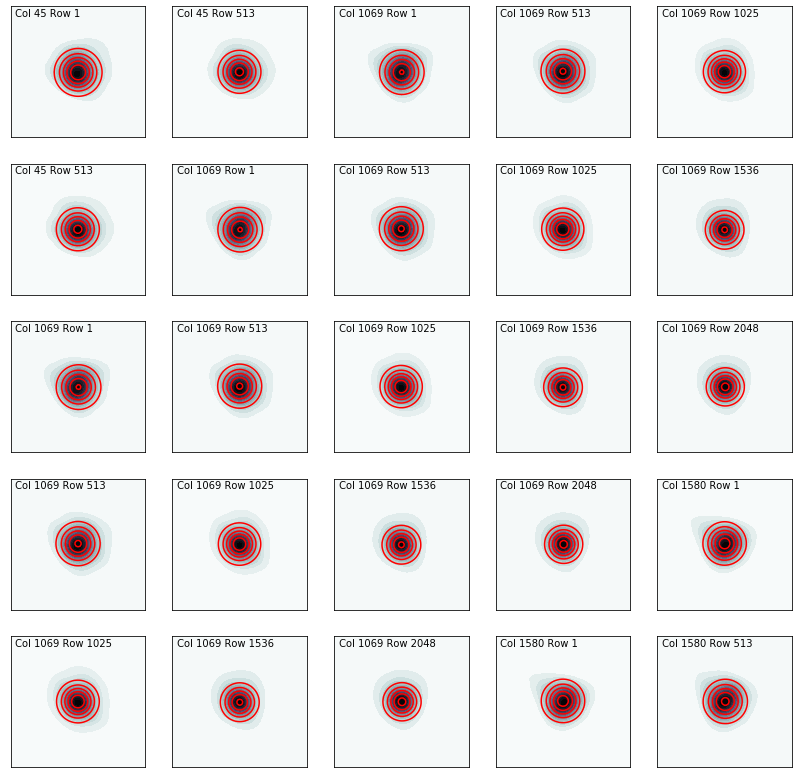



Camera 3 CCD 1


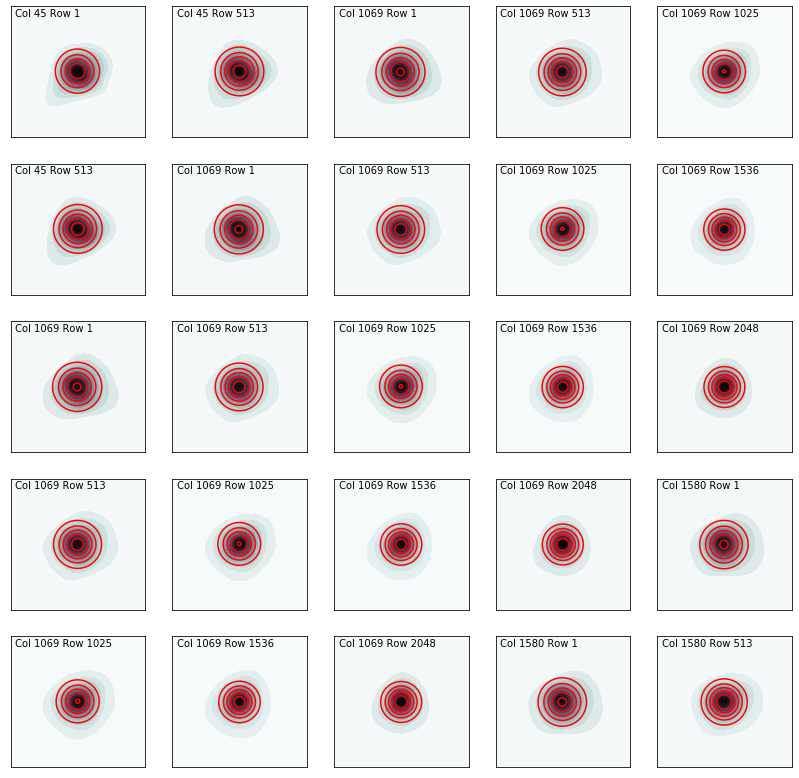



Camera 3 CCD 2


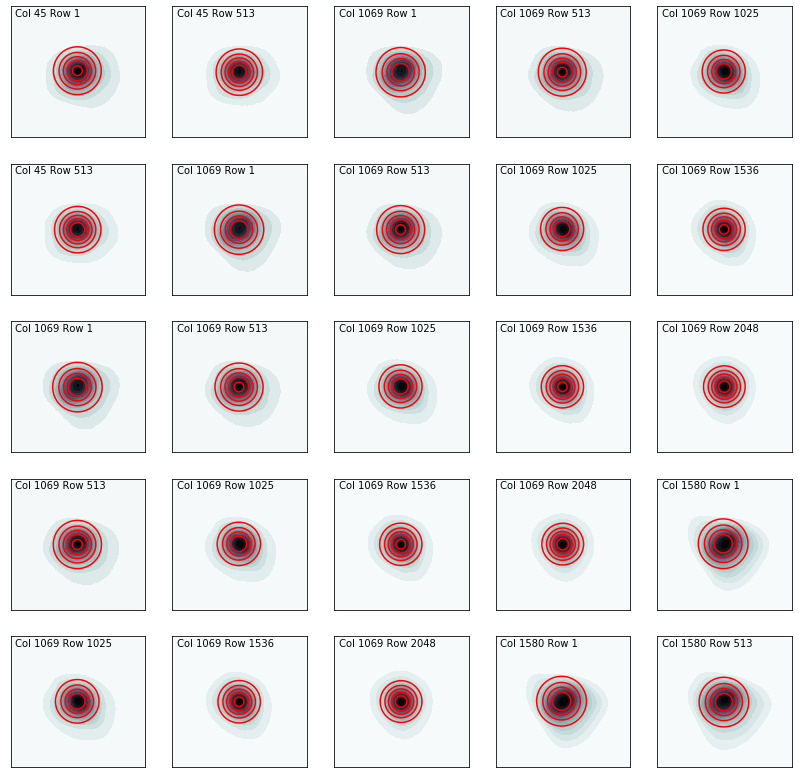



Camera 3 CCD 3


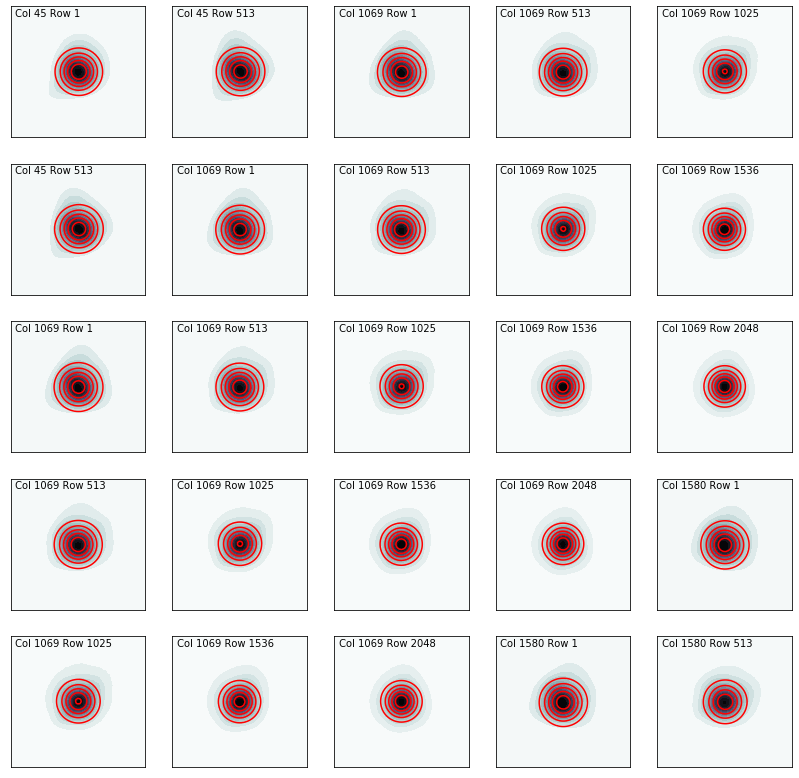



Camera 3 CCD 4


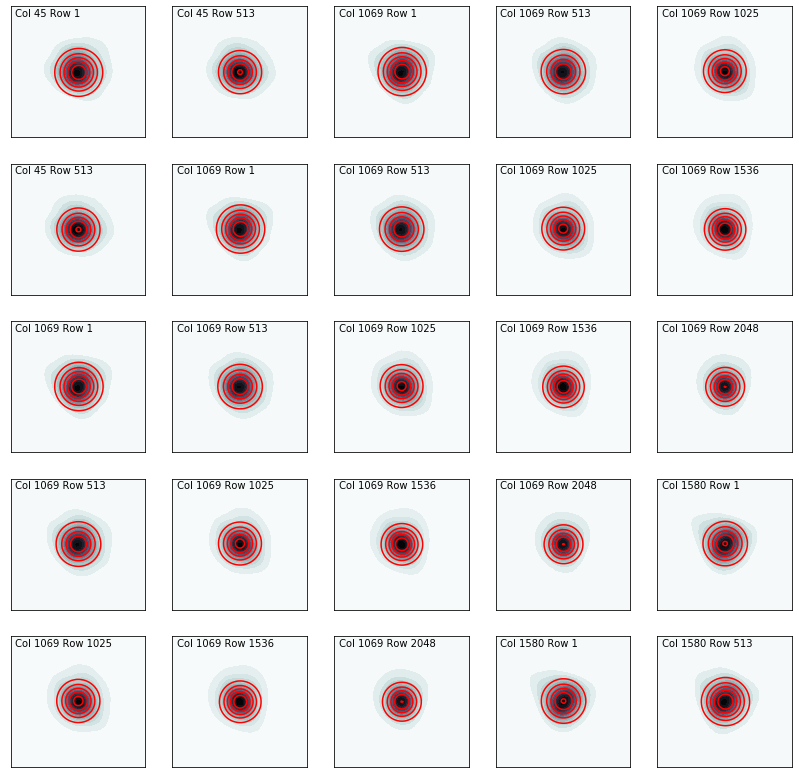



Camera 4 CCD 1


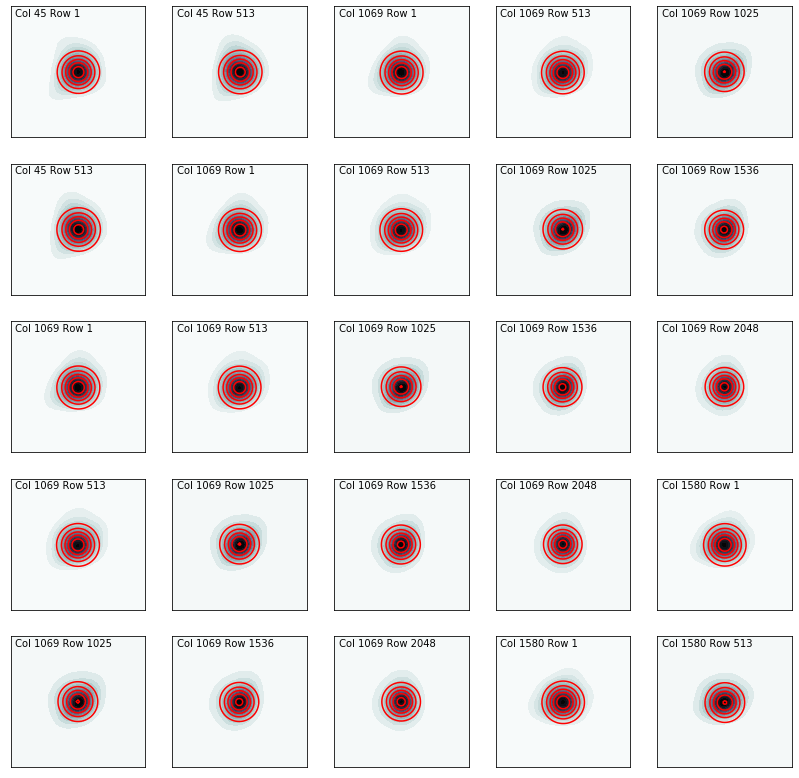



Camera 4 CCD 2


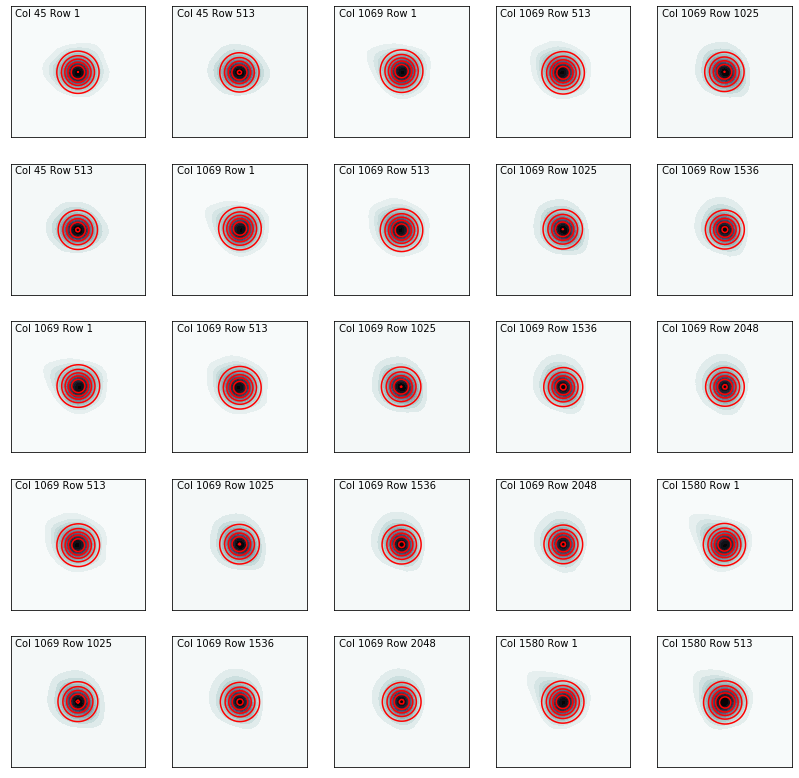



Camera 4 CCD 3


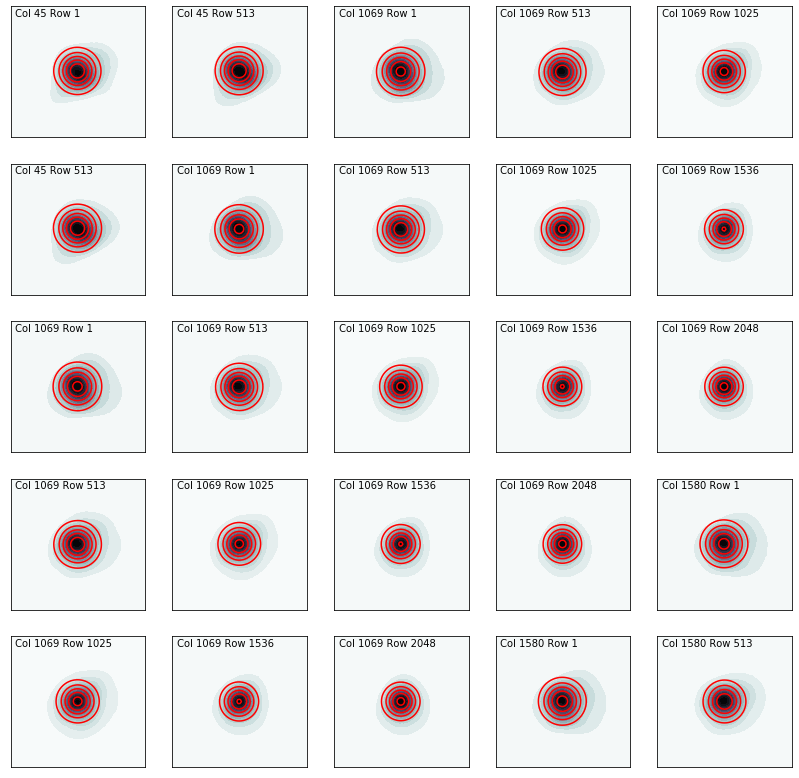



Camera 4 CCD 4


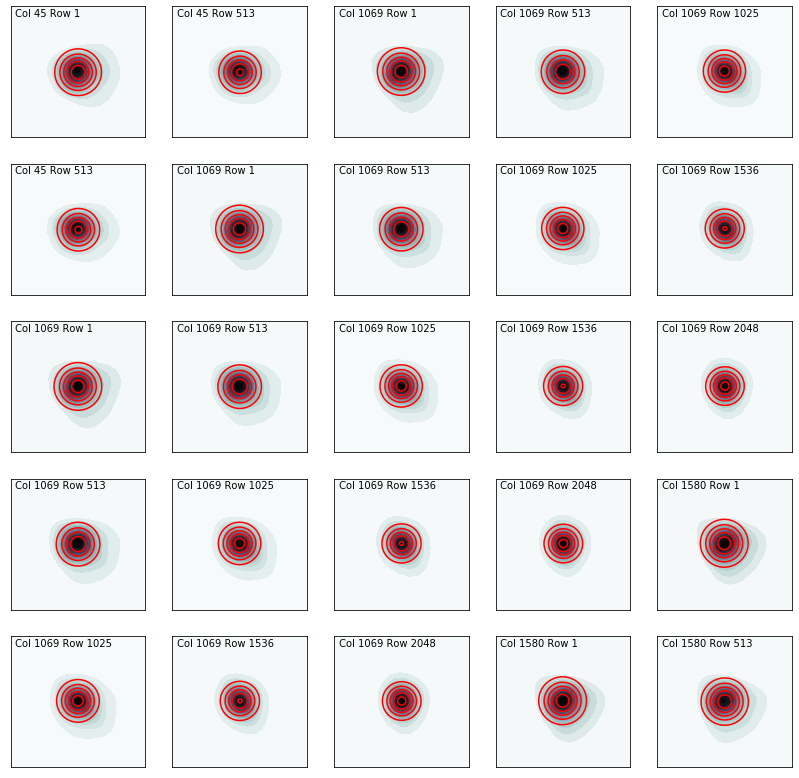

In [5]:
sec = []
cam = []
ccd = []
col = []
row = []
std1 = []
std2 = []
corr = []

for k,file in enumerate(sector1_files):

    # Read the TESS PRF file, which is a MATLAB data file:
    mat = loadmat('../data/tess_prf/s0001/'+str(file))
    mat = mat['prfStruct']
    print(f"Camera {file.split('-')[2]} CCD {file.split('-')[3]}")
    
    # Center around 0 and convert to PSF subpixel resolution:
    # We are just using the first one here, assuming they are all the same
    PRFx = np.asarray(mat['prfColumn'][0][0], dtype='float64').flatten()
    PRFy = np.asarray(mat['prfRow'][0][0], dtype='float64').flatten()

    # Find size of PSF images and
    # the pixel-scale of the PSF images:
    n_hdu = len(mat['values'][0])
    xdim = len(PRFx)
    ydim = len(PRFy)
    cdelt1p = np.median(np.diff(PRFx))
    cdelt2p = np.median(np.diff(PRFy))

    f, ax = plt.subplots(5,5,figsize=(14,14))
    for i in range(ax.shape[0]):
        for j in range(ax.shape[1]):
            prf = mat['values'][0][i+j]
            crval1p = float(mat['ccdColumn'][0][i+j])
            crval2p = float(mat['ccdRow'][0][i+j])
            
            xx, yy = np.meshgrid(PRFy, PRFx)
            prf += np.abs(prf.min()) + 1e-14 
            
            initial_guess = (1,0,0,1,0)
            popt, pcov = opt.curve_fit(twoD_Gaussian, (xx, yy), prf.ravel(), p0=initial_guess, method='lm')
            data_fitted = twoD_Gaussian((xx, yy), *popt)
            
            sec.append(1)
            cam.append(file.split('-')[2])
            ccd.append(file.split('-')[3])
            col.append(crval1p)
            row.append(crval2p)
            std1.append(popt[3])
            
            ax[i,j].contourf(yy, xx, prf, 20, cmap='bone_r')
            # comment out line below to remove Gaussian fits
            ax[i,j].contour(xx, yy, data_fitted.reshape(117, 117), 5, colors='r')
            ax[i,j].axis('equal')
            ax[i,j].text(x=-4,y=3.4,s=f" Col {int(crval1p)} Row {int(crval2p)}")
            ax[i,j].set_xlim([-4,4])
            ax[i,j].set_ylim([-4,4])
            ax[i,j].set_xticks([])
            ax[i,j].set_yticks([])
            
    plt.show()
    print()
    print()

Camera 1 CCD 1


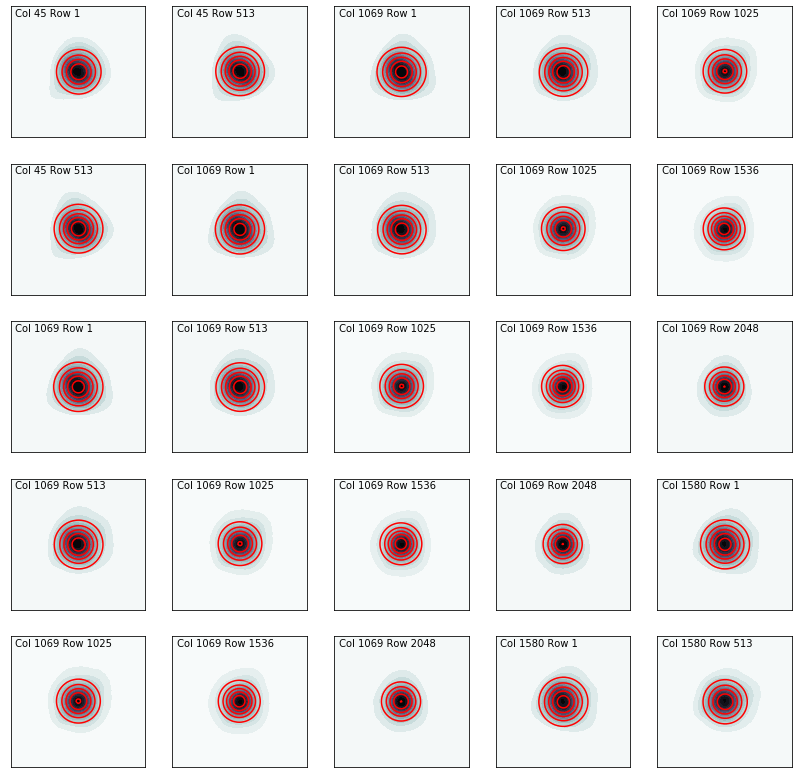



Camera 1 CCD 2


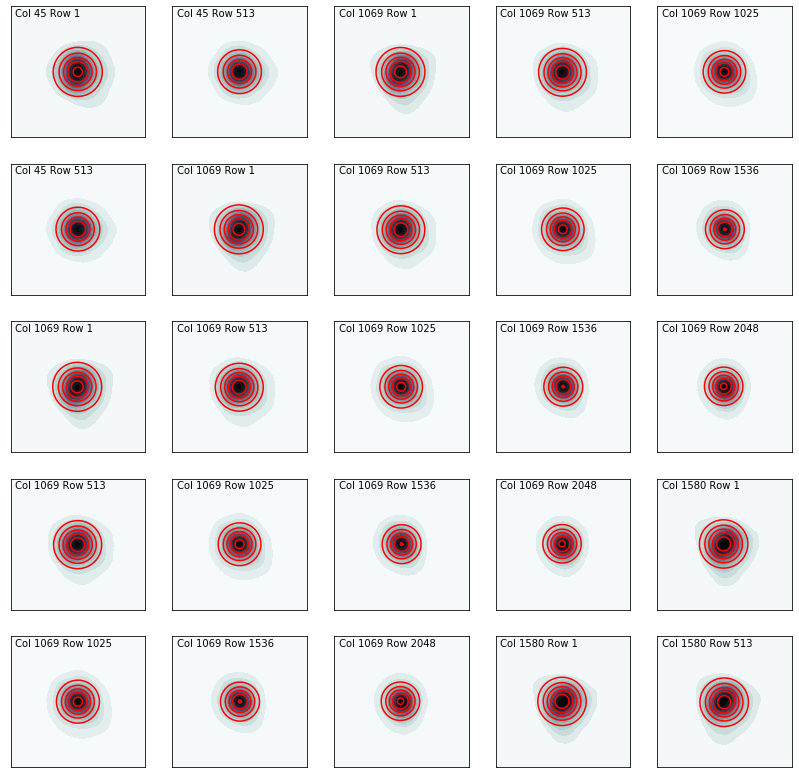



Camera 1 CCD 3


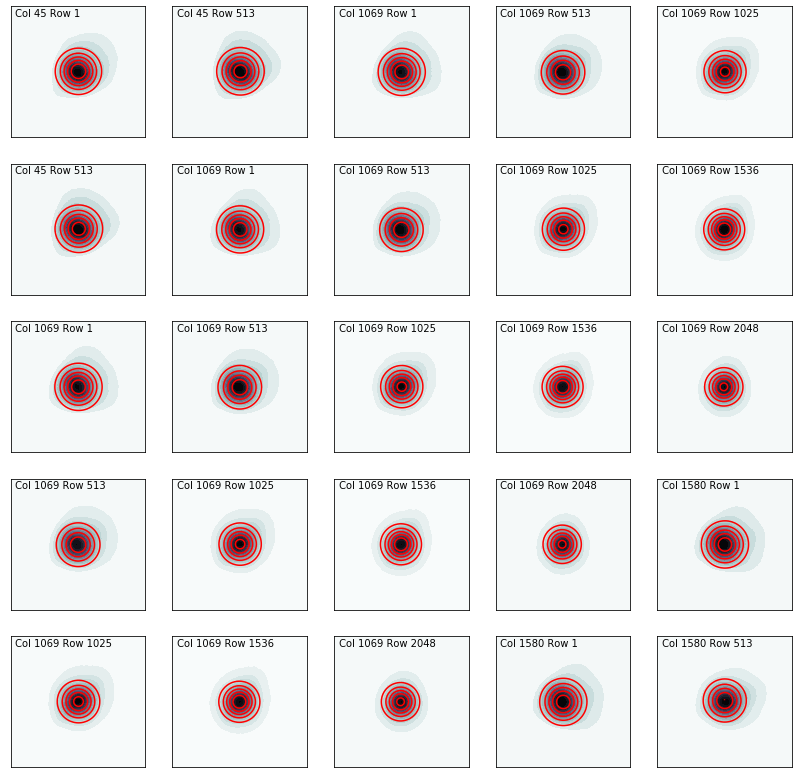



Camera 1 CCD 4


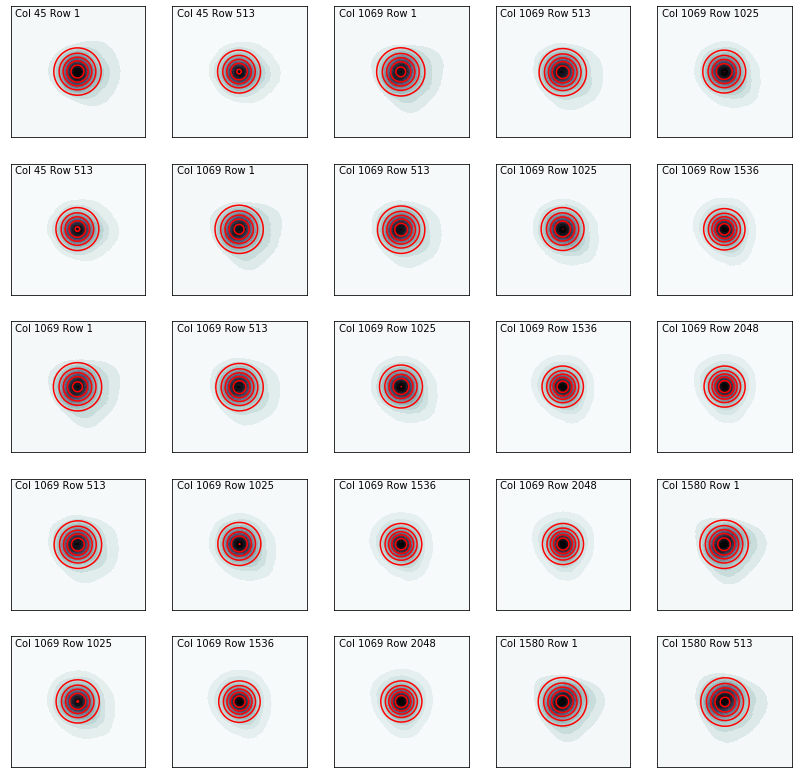



Camera 2 CCD 1


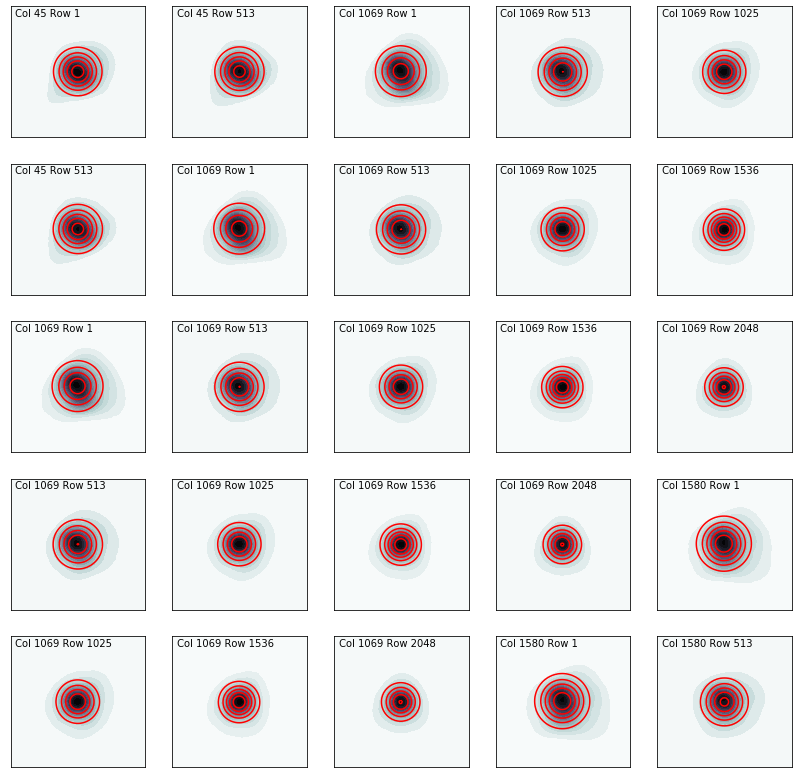



Camera 2 CCD 2


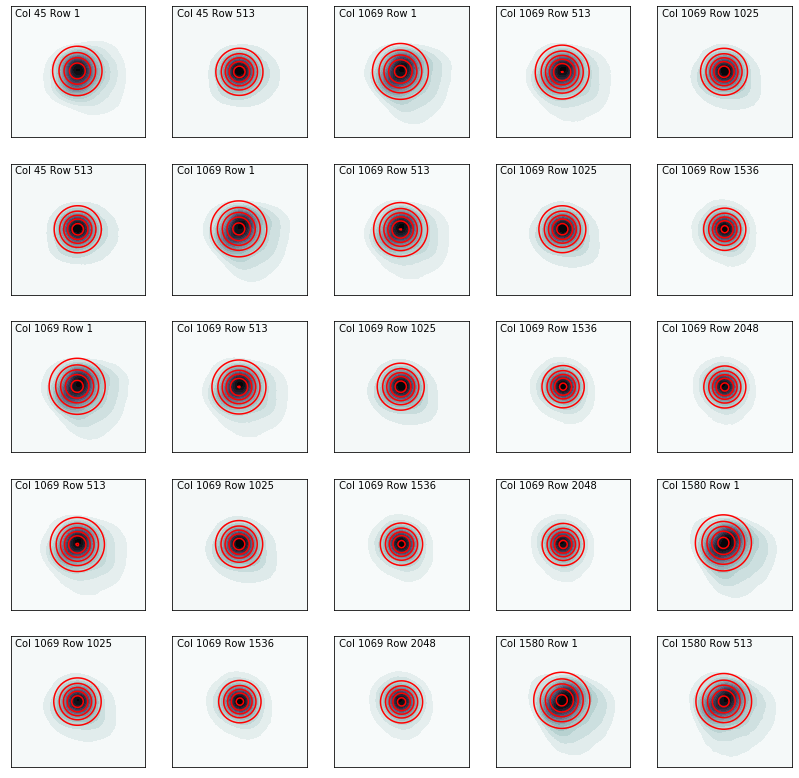



Camera 2 CCD 3


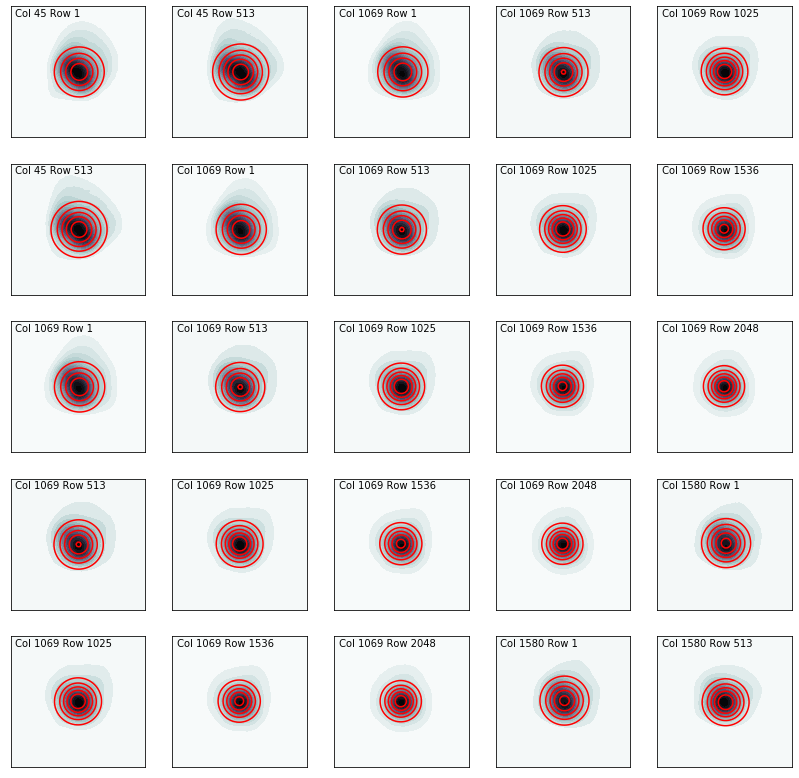



Camera 2 CCD 4


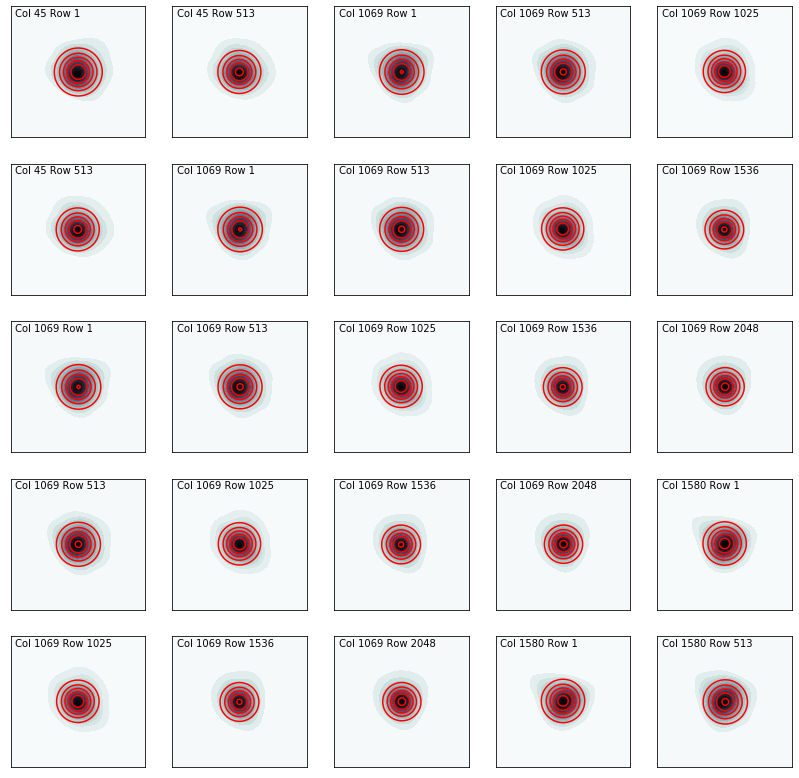



Camera 3 CCD 1


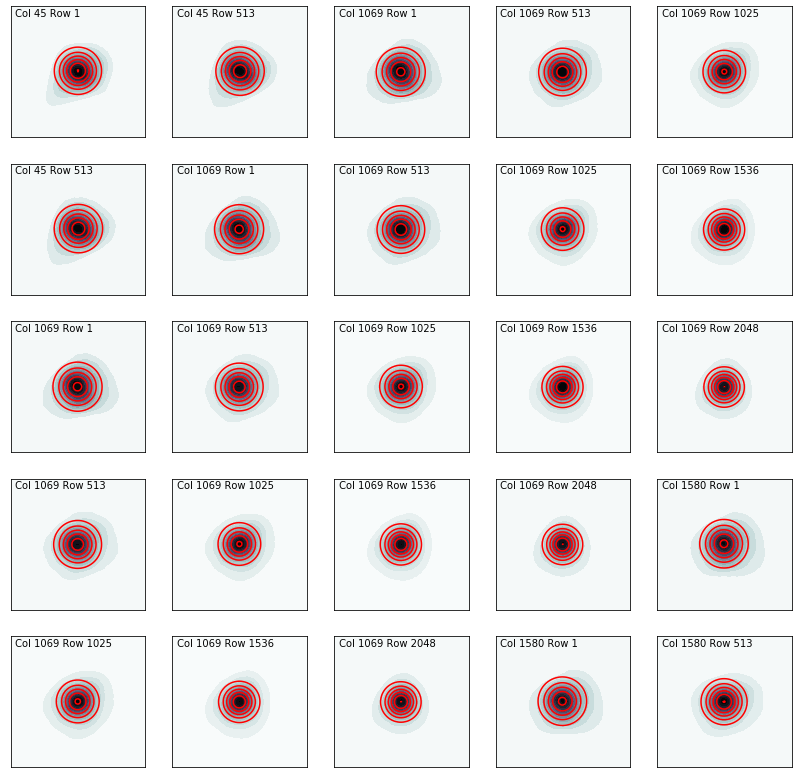



Camera 3 CCD 2


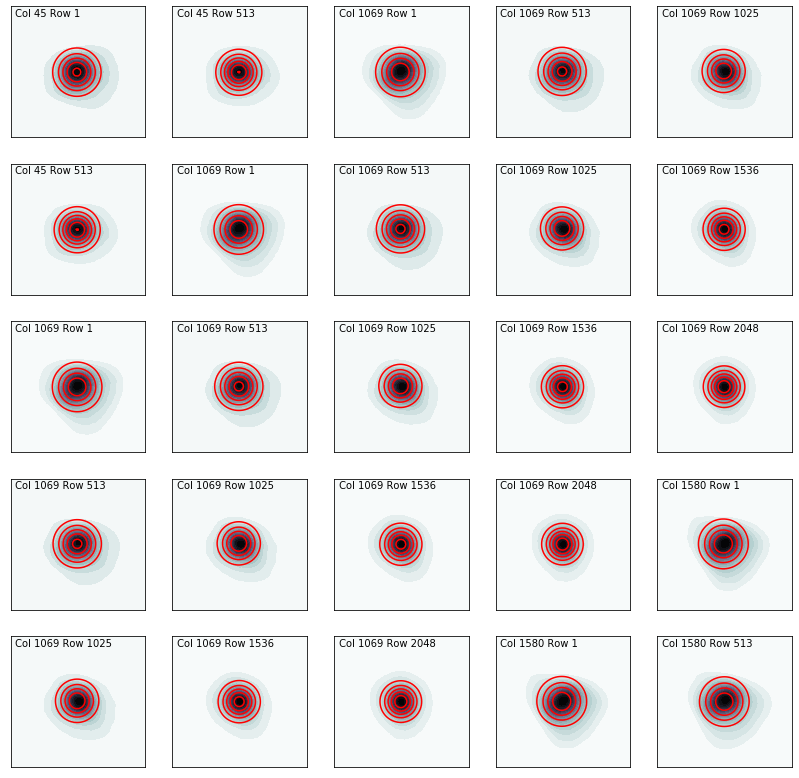



Camera 3 CCD 3


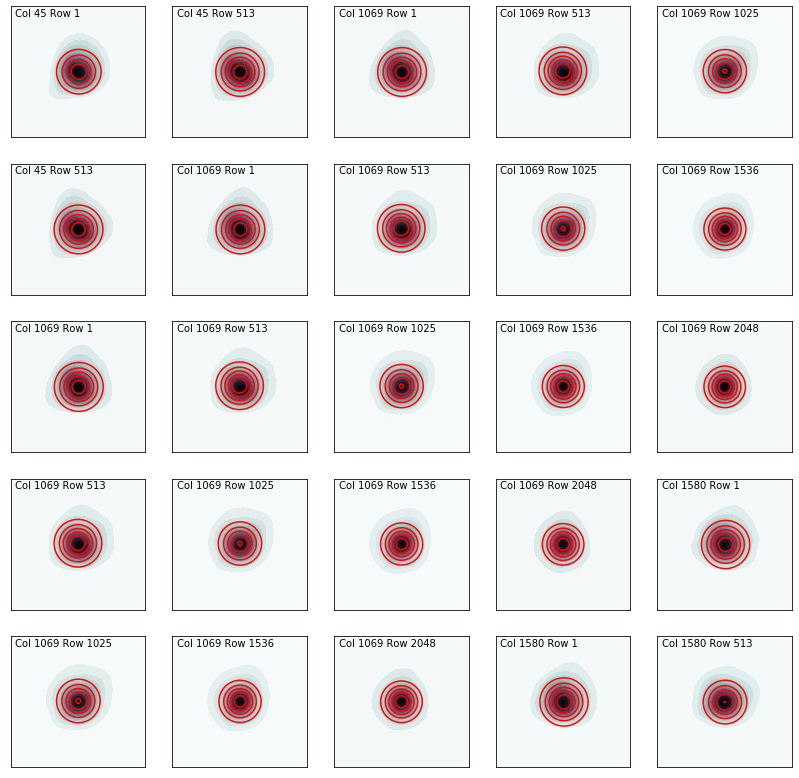



Camera 3 CCD 4


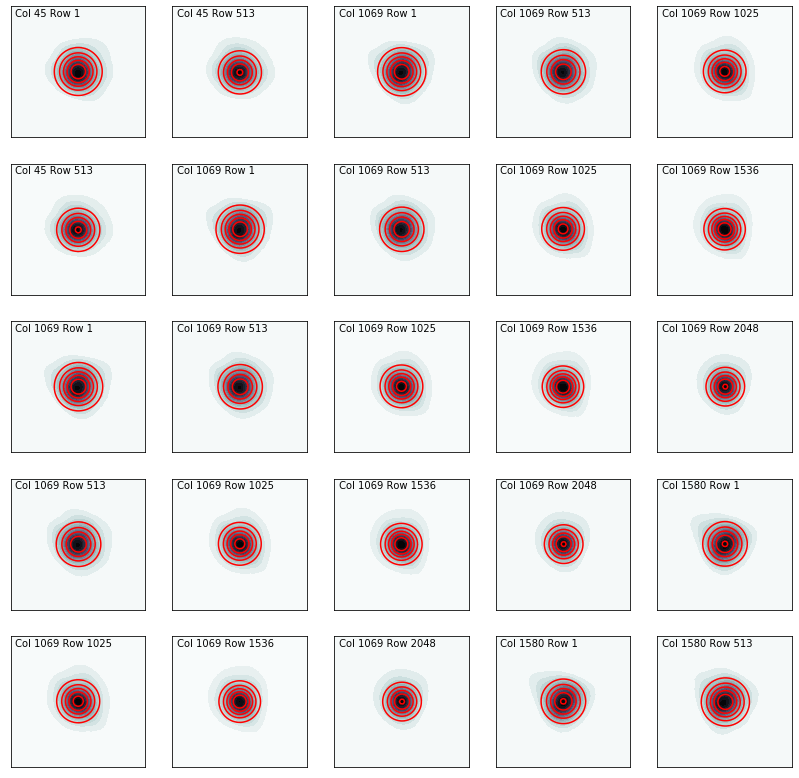



Camera 4 CCD 1


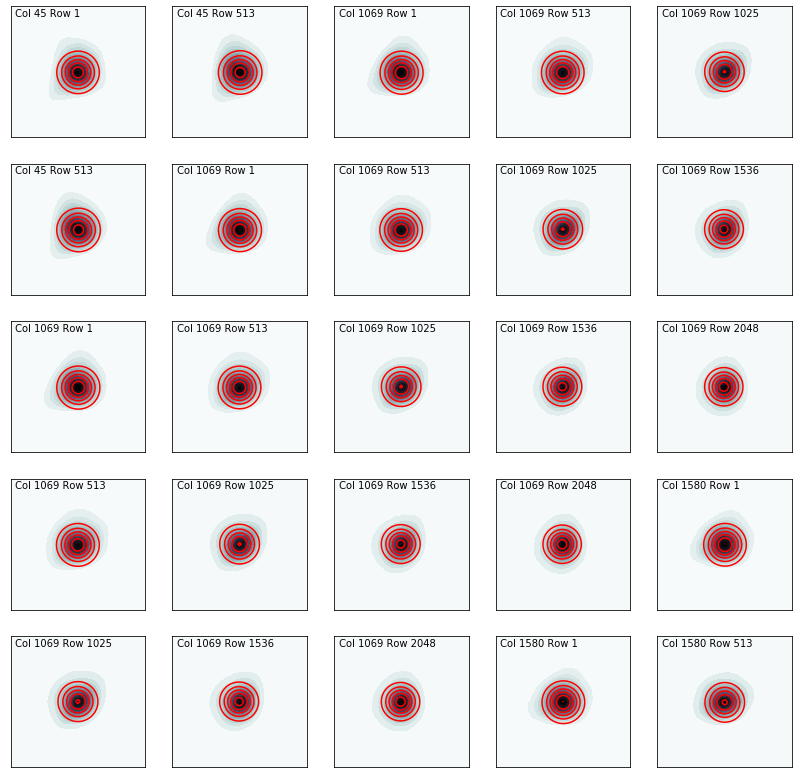



Camera 4 CCD 2


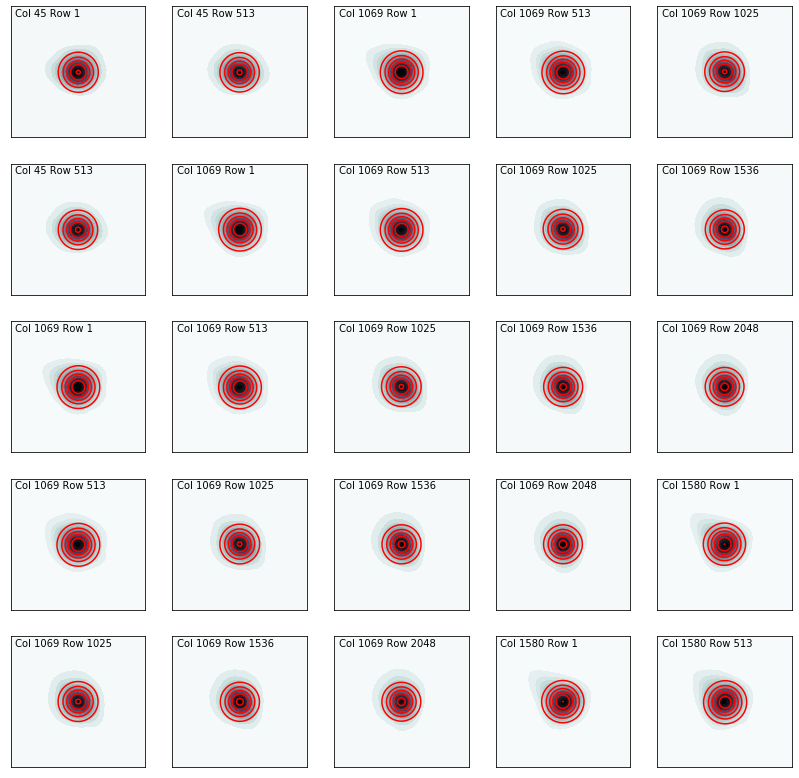



Camera 4 CCD 3


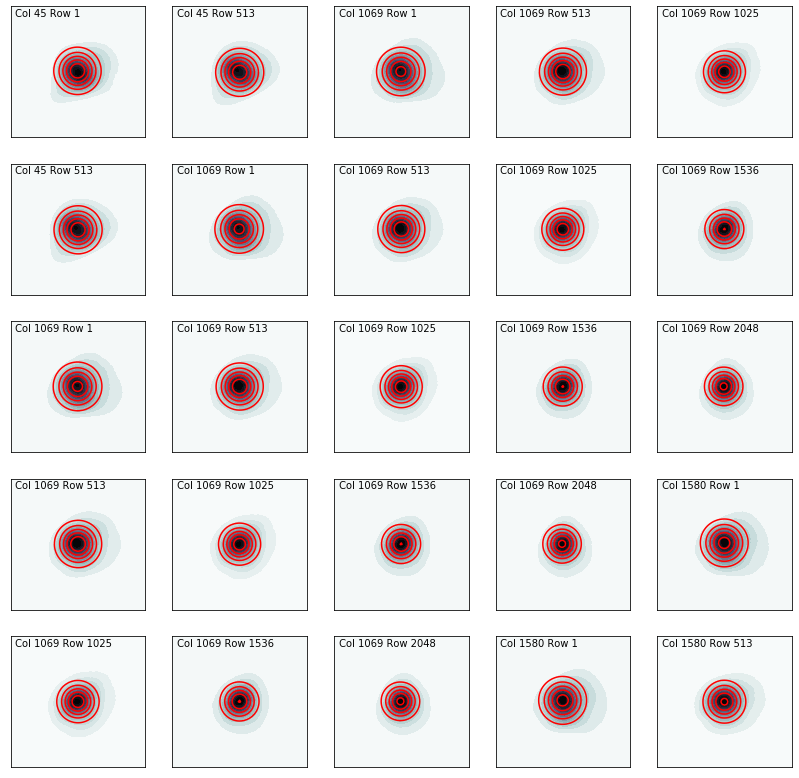



Camera 4 CCD 4


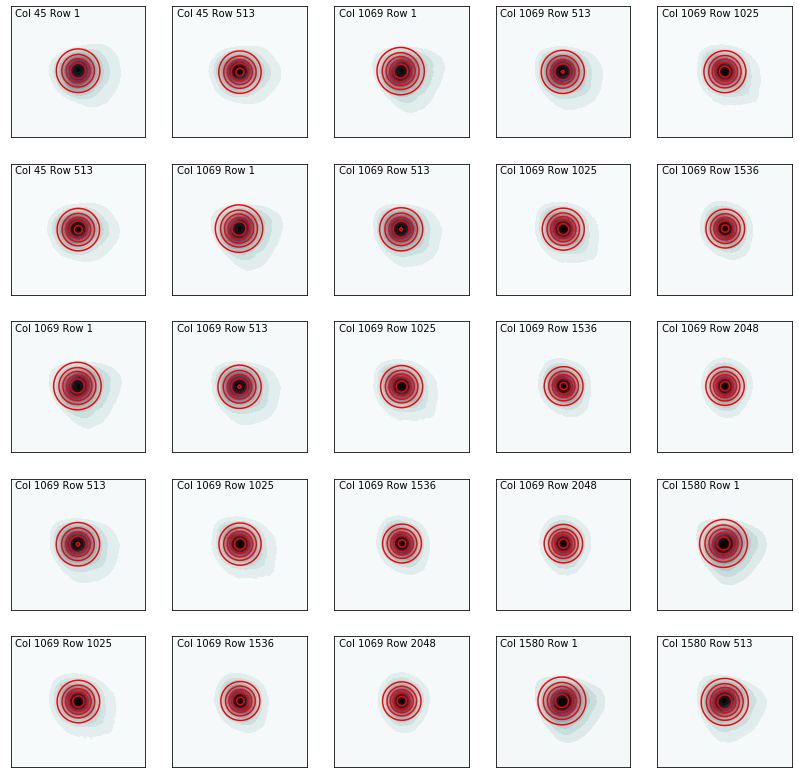

In [8]:
sec2 = []
cam2 = []
ccd2 = []
col2 = []
row2 = []
std12 = []
std22 = []
corr2 = []

for k,file in enumerate(sector4_files):

    # Read the TESS PRF file, which is a MATLAB data file:
    mat = loadmat('tess_prf/s0004/'+str(file))
    mat = mat['prfStruct']
    print(f"Camera {file.split('-')[2]} CCD {file.split('-')[3]}")
    
    # Center around 0 and convert to PSF subpixel resolution:
    # We are just using the first one here, assuming they are all the same
    PRFx = np.asarray(mat['prfColumn'][0][0], dtype='float64').flatten()
    PRFy = np.asarray(mat['prfRow'][0][0], dtype='float64').flatten()

    # Find size of PSF images and
    # the pixel-scale of the PSF images:
    n_hdu = len(mat['values'][0])
    xdim = len(PRFx)
    ydim = len(PRFy)
    cdelt1p = np.median(np.diff(PRFx))
    cdelt2p = np.median(np.diff(PRFy))

    f, ax = plt.subplots(5,5,figsize=(14,14));
    for i in range(ax.shape[0]):
        for j in range(ax.shape[1]):
            prf = mat['values'][0][i+j]
            crval1p = float(mat['ccdColumn'][0][i+j])
            crval2p = float(mat['ccdRow'][0][i+j])
            
            xx, yy = np.meshgrid(PRFy, PRFx)
            prf += np.abs(prf.min()) + 1e-14 
            
            initial_guess = (1,0,0,1,0)
            popt, pcov = opt.curve_fit(twoD_Gaussian, (xx, yy), prf.ravel(), p0=initial_guess, method='lm')
            data_fitted = twoD_Gaussian((xx, yy), *popt)
            
            sec2.append(4)
            cam2.append(file.split('-')[2])
            ccd2.append(file.split('-')[3])
            col2.append(crval1p)
            row2.append(crval2p)
            std12.append(popt[3])
            
            ax[i,j].contourf(yy, xx, prf, 20, cmap='bone_r')
            # comment out line below to remove Gaussian fits
            ax[i,j].contour(xx, yy, data_fitted.reshape(117, 117), 5, colors='r')
            ax[i,j].axis('equal')
            ax[i,j].text(x=-4,y=3.4,s=f" Col {int(crval1p)} Row {int(crval2p)}")
            ax[i,j].set_xlim([-4,4])
            ax[i,j].set_ylim([-4,4])
            ax[i,j].set_xticks([])
            ax[i,j].set_yticks([])
            
    plt.show()
    print()
    print()